In [ ]:
import pandas as pd
import numpy as np
from tensorflow import keras
from sklearn.metrics import classification_report, confusion_matrix ,jaccard_score , log_loss , accuracy_score ,ConfusionMatrixDisplay, roc_auc_score, roc_curve , auc, precision_recall_fscore_support
import matplotlib.pyplot as plt
from sklearn.preprocessing import  StandardScaler , MinMaxScaler , label_binarize
import urllib3
urllib3.disable_warnings()
import itertools
from bokeh.plotting import figure, show
from math import pi
import os
import requests
import zipfile
from sklearn.svm import SVC
from sklearn.decomposition import PCA
from sklearn.feature_selection import RFECV
from sklearn.model_selection import StratifiedKFold
from lime import lime_tabular
import shap
from sklearn.feature_selection import RFE

Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)


# Preparing Dataset

In [ ]:
# First i downloaded the file and then unzip it
# Define a function to load data from a file using NumPy's loadtxt method.
def load_file(filepath):
    return np.loadtxt(filepath)
# Define a function to load data for a specific group ('train' or 'test') and convert it into a pandas DataFrame.
def load_dataset_group_to_dataframe(group, base_path):
    filepath = os.path.join(base_path, group, 'X_' + group + '.txt')
    X = load_file(filepath) # Load the feature data from the file.
    X_df = pd.DataFrame(X)
    filepath = os.path.join(base_path, group, 'y_' + group + '.txt')
    y = load_file(filepath)  # Load the label data from the file.
    y_df = pd.DataFrame(y, columns=['Activity']) # Convert the label data into a DataFrame with a column name 'Activity'.
    return X_df, y_df

# Specify the base path to the dataset directory.
base_path = 'human+activity+recognition+using+smartphones/UCI HAR Dataset/'
X_train_df, y_train_df = load_dataset_group_to_dataframe('train', base_path)

X_test_df, y_test_df = load_dataset_group_to_dataframe('test', base_path)

features_path = os.path.join(base_path, 'features.txt')
features = pd.read_csv(features_path, delim_whitespace=True, header=None, names=['index', 'feature_name'])

# Assign feature names to the columns of the training and testing feature DataFrames.
X_train_df.columns = features['feature_name'].values
X_test_df.columns = features['feature_name'].values

X_train_df.head()

The 'delim_whitespace' keyword in pd.read_csv is deprecated and will be removed in a future version. Use ``sep='\s+'`` instead


,tBodyAcc-mean()-X,tBodyAcc-mean()-Y,tBodyAcc-mean()-Z,tBodyAcc-std()-X,tBodyAcc-std()-Y,tBodyAcc-std()-Z,tBodyAcc-mad()-X,tBodyAcc-mad()-Y,tBodyAcc-mad()-Z,tBodyAcc-max()-X,...,fBodyBodyGyroJerkMag-meanFreq(),fBodyBodyGyroJerkMag-skewness(),fBodyBodyGyroJerkMag-kurtosis(),"angle(tBodyAccMean,gravity)","angle(tBodyAccJerkMean),gravityMean)","angle(tBodyGyroMean,gravityMean)","angle(tBodyGyroJerkMean,gravityMean)","angle(X,gravityMean)","angle(Y,gravityMean)","angle(Z,gravityMean)"
0,0.288585,-0.020294,-0.132905,-0.995279,-0.983111,-0.913526,-0.995112,-0.983185,-0.923527,-0.934724,...,-0.074323,-0.298676,-0.710304,-0.112754,0.030400,-0.464761,-0.018446,-0.841247,0.179941,-0.058627
1,0.278419,-0.016411,-0.123520,-0.998245,-0.975300,-0.960322,-0.998807,-0.974914,-0.957686,-0.943068,...,0.158075,-0.595051,-0.861499,0.053477,-0.007435,-0.732626,0.703511,-0.844788,0.180289,-0.054317
2,0.279653,-0.019467,-0.113462,-0.995380,-0.967187,-0.978944,-0.996520,-0.963668,-0.977469,-0.938692,...,0.414503,-0.390748,-0.760104,-0.118559,0.177899,0.100699,0.808529,-0.848933,0.180637,-0.049118
3,0.279174,-0.026201,-0.123283,-0.996091,-0.983403,-0.990675,-0.997099,-0.982750,-0.989302,-0.938692,...,0.404573,-0.117290,-0.482845,-0.036788,-0.012892,0.640011,-0.485366,-0.848649,0.181935,-0.047663
4,0.276629,-0.016570,-0.115362,-0.998139,-0.980817,-0.990482,-0.998321,-0.979672,-0.990441,-0.942469,...,0.087753,-0.351471,-0.699205,0.123320,0.122542,0.693578,-0.615971,-0.847865,0.185151,-0.043892


In [ ]:
#statistical summary of the DataFrame
X_train_df.describe()

,tBodyAcc-mean()-X,tBodyAcc-mean()-Y,tBodyAcc-mean()-Z,tBodyAcc-std()-X,tBodyAcc-std()-Y,tBodyAcc-std()-Z,tBodyAcc-mad()-X,tBodyAcc-mad()-Y,tBodyAcc-mad()-Z,tBodyAcc-max()-X,...,fBodyBodyGyroJerkMag-meanFreq(),fBodyBodyGyroJerkMag-skewness(),fBodyBodyGyroJerkMag-kurtosis(),"angle(tBodyAccMean,gravity)","angle(tBodyAccJerkMean),gravityMean)","angle(tBodyGyroMean,gravityMean)","angle(tBodyGyroJerkMean,gravityMean)","angle(X,gravityMean)","angle(Y,gravityMean)","angle(Z,gravityMean)"
count,7352.000000,7352.000000,7352.000000,7352.000000,7352.000000,7352.000000,7352.000000,7352.000000,7352.000000,7352.000000,...,7352.000000,7352.000000,7352.000000,7352.000000,7352.000000,7352.000000,7352.000000,7352.000000,7352.000000,7352.000000
mean,0.274488,-0.017695,-0.109141,-0.605438,-0.510938,-0.604754,-0.630512,-0.526907,-0.606150,-0.468604,...,0.125293,-0.307009,-0.625294,0.008684,0.002186,0.008726,-0.005981,-0.489547,0.058593,-0.056515
std,0.070261,0.040811,0.056635,0.448734,0.502645,0.418687,0.424073,0.485942,0.414122,0.544547,...,0.250994,0.321011,0.307584,0.336787,0.448306,0.608303,0.477975,0.511807,0.297480,0.279122
min,-1.000000,-1.000000,-1.000000,-1.000000,-0.999873,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,...,-1.000000,-0.995357,-0.999765,-0.976580,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000
25%,0.262975,-0.024863,-0.120993,-0.992754,-0.978129,-0.980233,-0.993591,-0.978162,-0.980251,-0.936219,...,-0.023692,-0.542602,-0.845573,-0.121527,-0.289549,-0.482273,-0.376341,-0.812065,-0.017885,-0.143414
50%,0.277193,-0.017219,-0.108676,-0.946196,-0.851897,-0.859365,-0.950709,-0.857328,-0.857143,-0.881637,...,0.134000,-0.343685,-0.711692,0.009509,0.008943,0.008735,-0.000368,-0.709417,0.182071,0.003181
75%,0.288461,-0.010783,-0.097794,-0.242813,-0.034231,-0.262415,-0.292680,-0.066701,-0.265671,-0.017129,...,0.289096,-0.126979,-0.503878,0.150865,0.292861,0.506187,0.359368,-0.509079,0.248353,0.107659
max,1.000000,1.000000,1.000000,1.000000,0.916238,1.000000,1.000000,0.967664,1.000000,1.000000,...,0.946700,0.989538,0.956845,1.000000,1.000000,0.998702,0.996078,1.000000,0.478157,1.000000


In [ ]:
# Define a list of class names corresponding to activities in the dataset.
class_names = ['WALKING', 'WALKING_UPSTAIRS', 'WALKING_DOWNSTAIRS', 'SITTING', 'STANDING', 'LAYING']

In [ ]:
# Merge feature and activity label DataFrames to create a single training DataFrame.
train_df = pd.concat([X_train_df, y_train_df], axis=1)

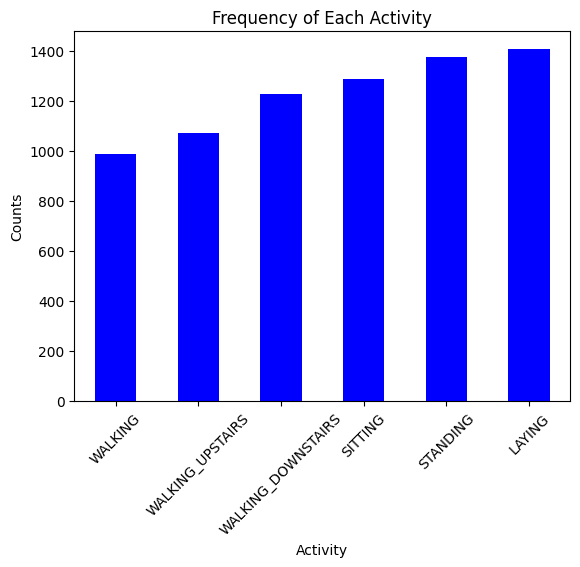

In [ ]:
# Plot a bar graph showing the count of each activity, sorted by frequency.
train_df['Activity'].value_counts().sort_values().plot(kind='bar', color='blue')
plt.xticks(ticks=range(len(class_names)), labels=class_names, rotation=45)
plt.xlabel('Activity')
plt.ylabel('Counts')
plt.title('Frequency of Each Activity')
plt.show()


In [ ]:
# Convert DataFrames to NumPy arrays
X_train = X_train_df.values
X_test = X_test_df.values
y_train = y_train_df.values
y_test = y_test_df.values

# Define Evaluation Functions

In [ ]:
# Define a function to plot ROC curves for multi-class classification.
def plot_multi_class_roc(y_test, yhat, class_names):
    y_true = label_binarize(y_test, classes=np.arange(len(class_names)))
    y_pred = label_binarize(yhat, classes=np.arange(len(class_names)))

    # Initialize dictionaries to store false positive and true positive rates, and AUC values.
    fp, tp, roc_auc = dict(), dict(), dict()
    for i in range(len(class_names)):
        fp[i], tp[i], _ = roc_curve(y_true[:, i], y_pred[:, i])
        roc_auc[i] = auc(fp[i], tp[i])

    # Plot the ROC curves for each class.
    plt.figure(figsize=(10, 6))
    for i in range(len(class_names)):
        plt.plot(fp[i], tp[i], label=f'ROC curve of {class_names[i]} (area = {roc_auc[i]:0.2f})')
    plt.plot([0, 1], [0, 1], 'k--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('FP Rate')
    plt.ylabel('TP Rate')
    plt.title('ROC for Multi-Class')
    plt.legend(title="Class and AUC", loc='center left', bbox_to_anchor=(1, 0.5))
    plt.show()


In [ ]:
# Define a function to evaluate classification outcomes.
def evaluate_classification(y_true, y_pred, class_names):

    # Compute the confusion matrix.
    cm = confusion_matrix(y_true, y_pred)
    print("Confusion Matrix:\n", cm)

    # Generate a classification report.
    cr = classification_report(y_true, y_pred, target_names=class_names)
    print("Classification Report:\n", cr)

    # Display the confusion matrix using Matplotlib.
    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_names)
    fig, ax = plt.subplots(figsize=(16,14))
    disp.plot(ax=ax, cmap='viridis')
    plt.title('Confusion Matrix Display')
    plt.show()


# Define Neural network

## prepare Input for Neural Network

In [ ]:
# Convert the feature data to float32 type for numerical stability and performance in neural network operations.
X_train = X_train.astype(np.float32)

# Display unique labels in the training data.
X_test = X_test.astype(np.float32)

# Reshape feature data for compatibility with Keras, adding a dimension for channels (needed for convolution operations).
np.unique(y_train)
X_train = X_train.reshape((X_train.shape[0], X_train.shape[1], 1))
X_test = X_test.reshape((X_test.shape[0], X_test.shape[1], 1))

# Determine the number of unique classes (activities) in the labels.
num_classes = len(np.unique(y_train))

# Set a random seed to ensure reproducibility of results.
seed = 42
np.random.seed(seed)

# Randomly shuffle the training data to ensure the model does not learn any unintentional order effects.
idx = np.random.permutation(len(X_train))
X_train = X_train[idx]
y_train = y_train[idx]

# Convert labels to float32 type, typically done before subtracting 1 in the next step.
y_train = y_train.astype('float32')
y_test = y_test.astype('float32')
# Adjust label values to start from 0 instead of 1 (if they originally start from 1), necessary for certain types of classification.
y_train -= 1
y_test -= 1

# Print the shapes of the datasets to confirm their dimensions.
print("X_train shape : ",X_train.shape)
print("X_test shape : ",X_test.shape)
print("y_train shape : ",y_train.shape)
print("y_test shape : ",y_test.shape)

X_train shape :  (7352, 561, 1)
X_test shape :  (2947, 561, 1)
y_train shape :  (7352, 1)
y_test shape :  (2947, 1)


## Define CNN model

In [ ]:
# Define a neural network model for activity recognition.
def neural_network_model(input_shape):
    # Define the input layer with the specified shape.
    input_layer = keras.layers.Input(input_shape)

    # First convolutional layer with 64 filters, a kernel size of 3, and batch normalization followed by ReLU activation.
    conv1 = keras.layers.Conv1D(filters=64, kernel_size=3, padding="same")(input_layer)
    conv1 = keras.layers.BatchNormalization()(conv1)
    conv1 = keras.layers.ReLU()(conv1)

    # Second convolutional layer, similarly configured but with a kernel size of 4.
    conv2 = keras.layers.Conv1D(filters=64, kernel_size=4, padding="same")(conv1)
    conv2 = keras.layers.BatchNormalization()(conv2)
    conv2 = keras.layers.ReLU()(conv2)

    # Third convolutional layer, identical settings as the second.
    conv3 = keras.layers.Conv1D(filters=64, kernel_size=4, padding="same")(conv2)
    conv3 = keras.layers.BatchNormalization()(conv3)
    conv3 = keras.layers.ReLU()(conv3)

    # Global average pooling to reduce the dimensionality before the final layer.
    gap = keras.layers.GlobalAveragePooling1D()(conv3)

    # Output layer with a softmax activation to classify into the respective activity classes.
    output_layer = keras.layers.Dense(num_classes, activation="softmax")(gap)

    return keras.models.Model(inputs=input_layer, outputs=output_layer)


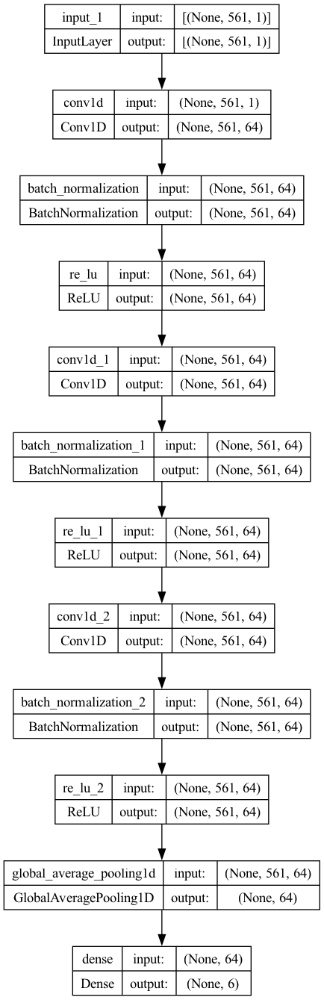

In [ ]:
#initialize the neural network model
model = neural_network_model(input_shape=X_train.shape[1:])

#generate a diagram of the model’s architecture
keras.utils.plot_model(model, show_shapes=True)

## Train model

In [ ]:
model = neural_network_model(input_shape=X_train.shape[1:])

# Set the number of epochs and batch size.
epochs = 30
batch_size = 16

# Define callbacks for enhanced training control:
callbacks = [
    keras.callbacks.ModelCheckpoint(
        "best_model.h5", save_best_only=True, monitor="val_loss"
    ),
    keras.callbacks.ReduceLROnPlateau(
        monitor="val_loss", factor=0.5, patience=5, min_lr=0.0001
    ),
    keras.callbacks.EarlyStopping(monitor="val_loss", patience=5, verbose=1),
]

# Compile the model with the Adam optimizer and sparse categorical crossentropy loss function, and track accuracy.
model.compile(
    optimizer="adam",
    loss="sparse_categorical_crossentropy",
    metrics=["sparse_categorical_accuracy"]
)

# Fit the model to the training data, with a portion reserved for validation, and using the defined callbacks.
history = model.fit(
    X_train,
    y_train,
    batch_size=batch_size,
    shuffle=False,
    epochs=epochs,
    callbacks=callbacks,
    validation_split=0.2,
    verbose=1
)


Epoch 1/30
368/368 [==============================] - 23s 58ms/step - loss: 1.0919 - sparse_categorical_accuracy: 0.5186 - val_loss: 6.4848 - val_sparse_categorical_accuracy: 0.1713 - lr: 0.0010
Epoch 2/30
  2/368 [..............................] - ETA: 22s - loss: 0.9277 - sparse_categorical_accuracy: 0.7812

/Users/hosseinsharafzad/anaconda3/envs/ann_course/lib/python3.10/site-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


368/368 [==============================] - 21s 57ms/step - loss: 0.8792 - sparse_categorical_accuracy: 0.6463 - val_loss: 1.2734 - val_sparse_categorical_accuracy: 0.5581 - lr: 0.0010
Epoch 3/30
368/368 [==============================] - 21s 57ms/step - loss: 0.7415 - sparse_categorical_accuracy: 0.7052 - val_loss: 0.8605 - val_sparse_categorical_accuracy: 0.5588 - lr: 0.0010
Epoch 4/30
368/368 [==============================] - 21s 57ms/step - loss: 0.6313 - sparse_categorical_accuracy: 0.7584 - val_loss: 0.9316 - val_sparse_categorical_accuracy: 0.4942 - lr: 0.0010
Epoch 5/30
368/368 [==============================] - 21s 57ms/step - loss: 0.5447 - sparse_categorical_accuracy: 0.8062 - val_loss: 1.1358 - val_sparse_categorical_accuracy: 0.5731 - lr: 0.0010
Epoch 6/30
368/368 [==============================] - 21s 57ms/step - loss: 0.4830 - sparse_categorical_accuracy: 0.8317 - val_loss: 0.9629 - val_sparse_categorical_accuracy: 0.5425 - lr: 0.0010
Epoch 7/30
368/368 [================

In [ ]:
# Load the best model saved.
model_nn = keras.models.load_model("best_model.h5")

## Evaluate Model

In [ ]:
# Evaluate the model on the test data to get loss and accuracy metrics.
test_loss, test_acc = model.evaluate(X_test, y_test)
print("Test accuracy", test_acc)
print("Test loss", test_loss)

# Make predictions on the test dataset using the loaded model.
predictions_cnn = model_nn.predict(X_test)

93/93 [==============================] - 1s 10ms/step - loss: 1.3406 - sparse_categorical_accuracy: 0.6162
Test accuracy 0.6162198781967163
Test loss 1.3406479358673096
93/93 [==============================] - 1s 10ms/step


In [ ]:
# Convert prediction probabilities to class index.
predictions_cnn = np.argmax(predictions_cnn, axis=1)
predictions_cnn

array([4, 4, 4, ..., 0, 0, 0])

In [ ]:
# Flatten y_test to match the predictions' shape, necessary for comparison.
y_test_reval = y_test.ravel()

Confusion Matrix:
 [[486   0  10   0   0   0]
 [251 161  59   0   0   0]
 [ 95   2 323   0   0   0]
 [  0   0   0 407  66  18]
 [  3   0   3  88 437   1]
 [  0   0   1   1   0 535]]
Classification Report:
                     precision    recall  f1-score   support

           WALKING       0.58      0.98      0.73       496
  WALKING_UPSTAIRS       0.99      0.34      0.51       471
WALKING_DOWNSTAIRS       0.82      0.77      0.79       420
           SITTING       0.82      0.83      0.82       491
          STANDING       0.87      0.82      0.84       532
            LAYING       0.97      1.00      0.98       537

          accuracy                           0.80      2947
         macro avg       0.84      0.79      0.78      2947
      weighted avg       0.84      0.80      0.79      2947



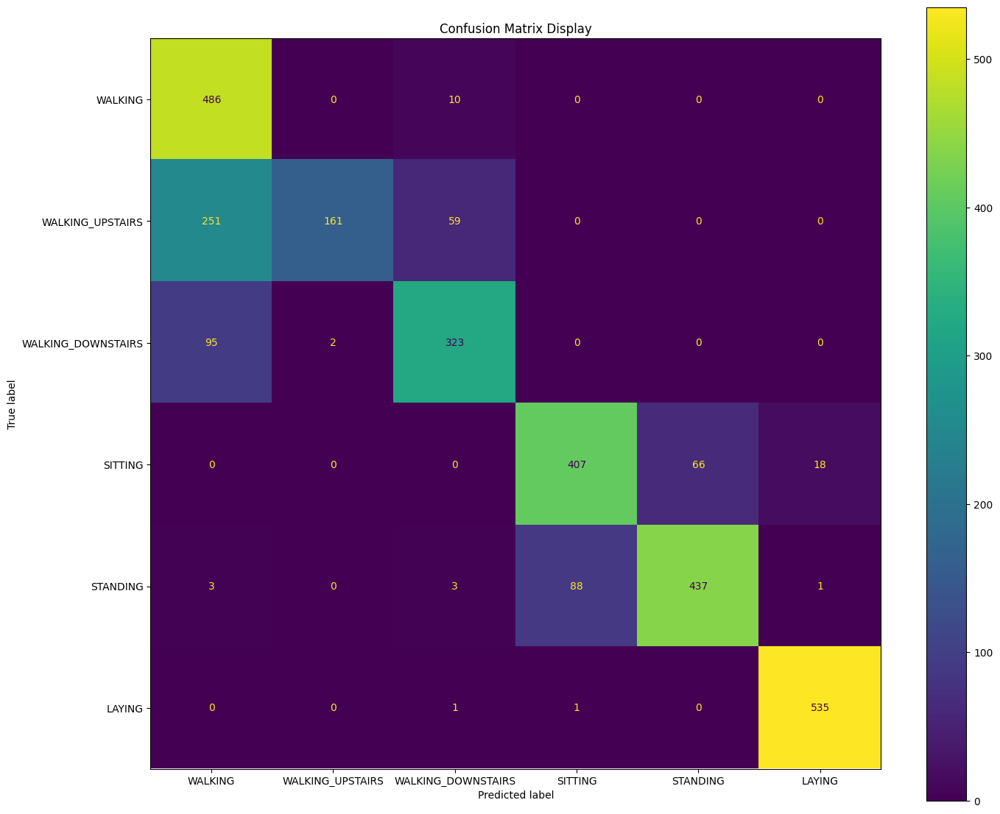

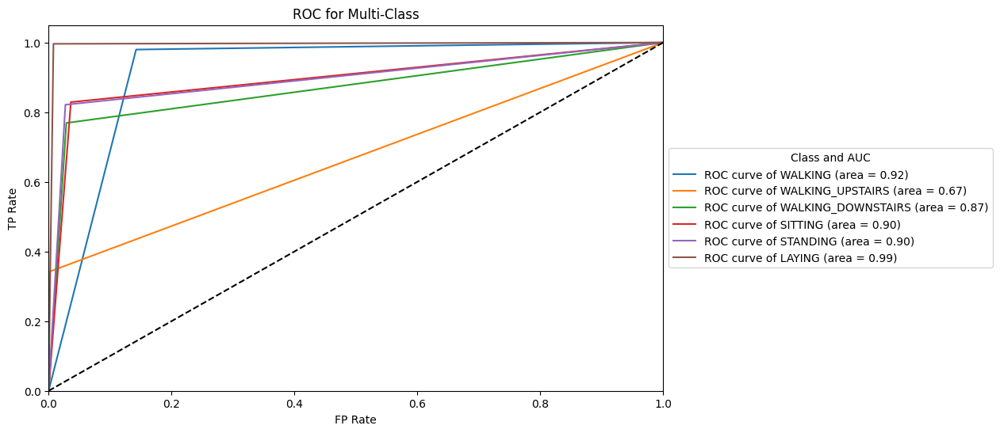

In [ ]:
# Evaluate the classification using the defined function; print confusion matrix and classification report.
evaluate_classification(y_test_reval, predictions_cnn ,class_names )

# Plot ROC curves for each class to assess the model's performance in classifying each activity.
plot_multi_class_roc(y_test_reval, predictions_cnn ,class_names)

# Simple Machine learnign model

In [ ]:
# Flatten the y_train array to make it suitable for training the SVM classifier.
y_train_ravel = y_train.ravel()

In [ ]:
# Reshape X_train and X_test to 2D, which is necessary for the scaler and SVM classifier.
X_train_reshaped = X_train.reshape(X_train.shape[0], X_train.shape[1])
X_test_reshaped = X_test.reshape(X_test.shape[0], X_test.shape[1])

In [ ]:
# Initialize the StandardScaler to normalize the data, improving the SVM classifier's performance.
scaler = StandardScaler()

# Fit the scaler on the training data and transform both training and test data.
X_train_scaled = scaler.fit_transform(X_train_reshaped)
X_test_scaled = scaler.transform(X_test_reshaped)

In [ ]:
# Initialize the SVM classifier with a radial basis function (RBF) kernel.
svm_classifier = SVC(kernel='rbf', probability=True)

# Train the SVM classifier using the scaled training data.
svm_classifier.fit(X_train_scaled, y_train_ravel)


SVC(probability=True)

In [ ]:
# Predict the class labels for the scaled test data.
y_pred_ml= svm_classifier.predict(X_test_scaled)

Confusion Matrix:
 [[482   6   8   0   0   0]
 [ 14 456   1   0   0   0]
 [  6  28 386   0   0   0]
 [  0   1   0 442  46   2]
 [  0   0   0  29 503   0]
 [  0   0   0   0   0 537]]
Classification Report:
                     precision    recall  f1-score   support

           WALKING       0.96      0.97      0.97       496
  WALKING_UPSTAIRS       0.93      0.97      0.95       471
WALKING_DOWNSTAIRS       0.98      0.92      0.95       420
           SITTING       0.94      0.90      0.92       491
          STANDING       0.92      0.95      0.93       532
            LAYING       1.00      1.00      1.00       537

          accuracy                           0.95      2947
         macro avg       0.95      0.95      0.95      2947
      weighted avg       0.95      0.95      0.95      2947



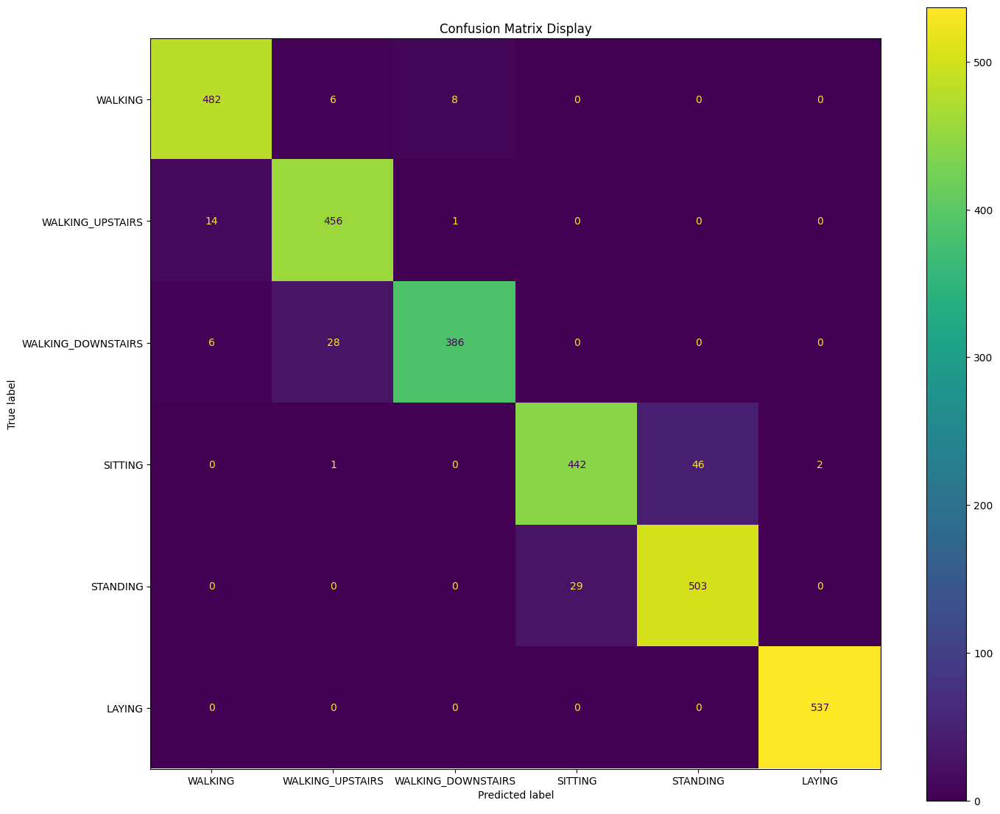

/Users/hosseinsharafzad/anaconda3/envs/ann_course/lib/python3.10/site-packages/sklearn/metrics/_ranking.py:1133: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  warnings.warn(


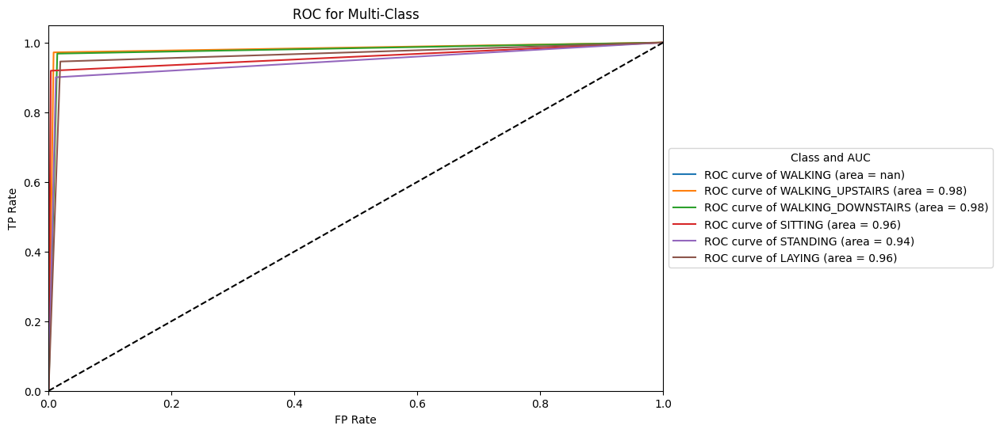

In [ ]:
# Evaluate the SVM classifier performance using the classification report and confusion matrix.
evaluate_classification(y_test_reval, y_pred_ml ,class_names)
# Plot ROC curves for each class to assess the classifier's ability to discriminate between classes.
plot_multi_class_roc(y_test_reval, y_pred_ml ,class_names)

# Principal Component Analysis

In [ ]:
# Initialize PCA with the number of components to keep 95% of the variance.
pca = PCA(n_components=0.95)

# Fit PCA on the scaled training data to identify the principal components.
pca.fit(X_train_scaled)

# Transform both training and testing datasets into the new PCA feature space.
X_train_pca = pca.transform(X_train_scaled)
X_test_pca = pca.transform(X_test_scaled)

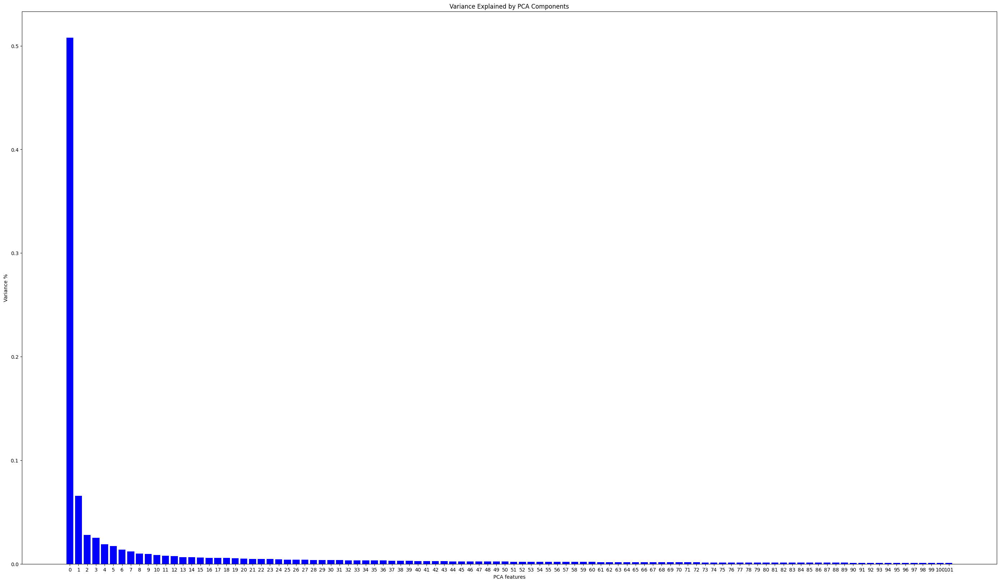

Total variance: 0.9507557


In [ ]:
# Get the indices of the PCA components.
features = range(pca.n_components_)

# Plot the variance explained by each PCA component.
plt.figure(figsize=(35, 20))
plt.bar(features, pca.explained_variance_ratio_, color='blue')
plt.xlabel('PCA features')
plt.ylabel('Variance %')
plt.xticks(features)
plt.title('Variance Explained by PCA Components')
plt.show()

# Print the total variance captured by the PCA components.
print("Total variance:", np.sum(pca.explained_variance_ratio_))


In [ ]:
# Initialize the SVM classifier with default parameters.
classifier = SVC()

# Fit the SVM classifier on the training data transformed by PCA.
classifier.fit(X_train_pca, y_train_ravel)

# Predict the class labels on the PCA-transformed test data.
predictions_pca = classifier.predict(X_test_pca)

# Calculate the accuracy of the model on the test data.
accuracy = accuracy_score(y_test, predictions_pca)
print("Model accuracy:", accuracy)

Model accuracy: 0.9379029521547336


Confusion Matrix:
 [[480   8   8   0   0   0]
 [ 22 444   5   0   0   0]
 [  4  45 371   0   0   0]
 [  0   1   0 432  56   2]
 [  0   0   0  32 500   0]
 [  0   0   0   0   0 537]]
Classification Report:
                     precision    recall  f1-score   support

           WALKING       0.95      0.97      0.96       496
  WALKING_UPSTAIRS       0.89      0.94      0.92       471
WALKING_DOWNSTAIRS       0.97      0.88      0.92       420
           SITTING       0.93      0.88      0.90       491
          STANDING       0.90      0.94      0.92       532
            LAYING       1.00      1.00      1.00       537

          accuracy                           0.94      2947
         macro avg       0.94      0.94      0.94      2947
      weighted avg       0.94      0.94      0.94      2947



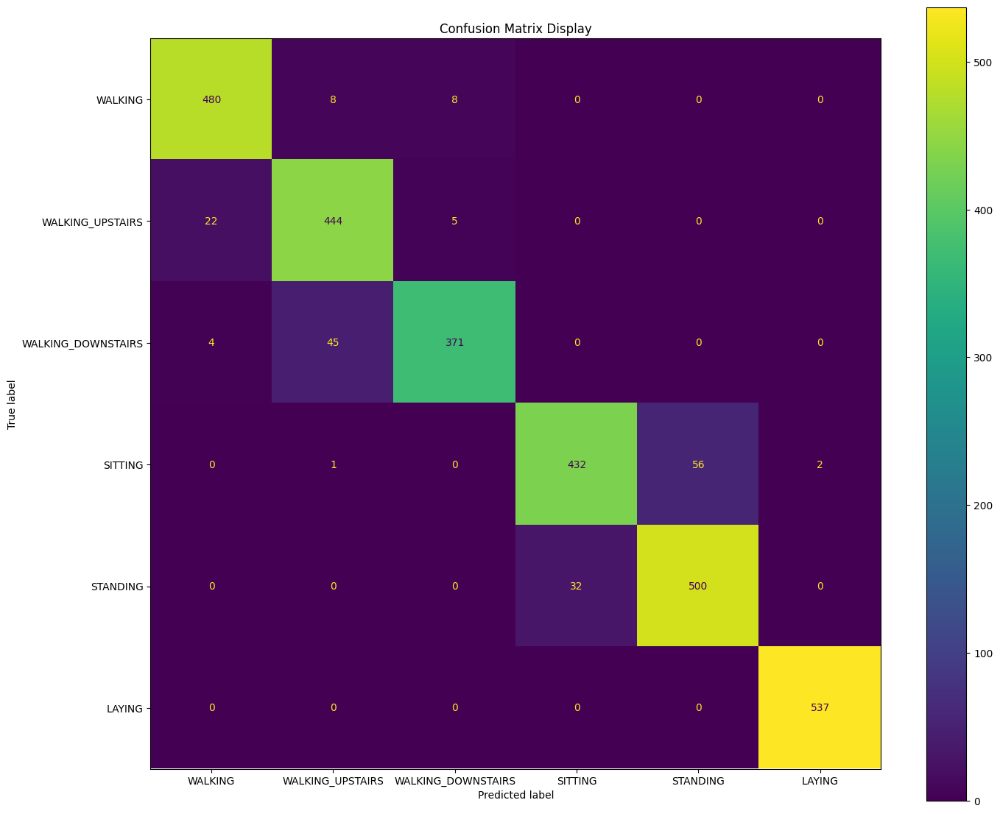

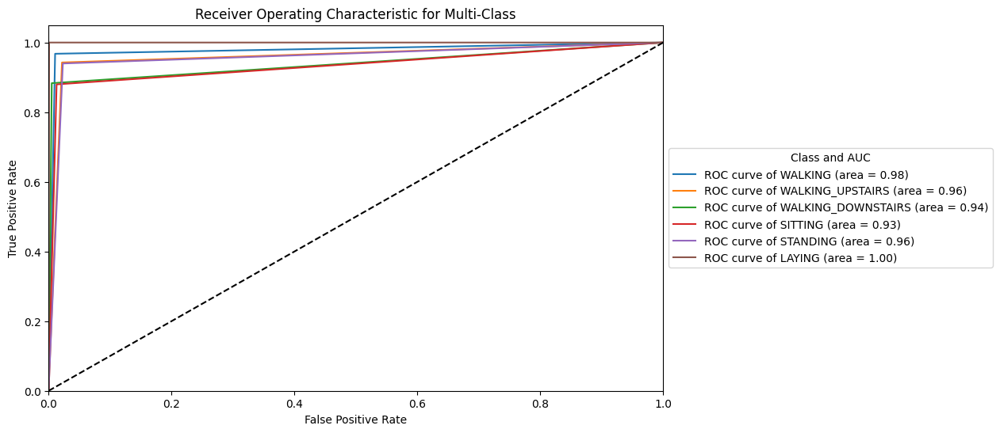

In [ ]:
# Evaluate the classification using the confusion matrix and classification report.
evaluate_classification(y_test, predictions_pca ,class_names)

# Plot ROC curves for each class to evaluate the model's discriminative performance.
plot_multi_class_roc(y_test, predictions_pca ,class_names)

# Feature Selection

In [ ]:
# Initialize an SVM classifier with a linear kernel.
svc_fs = SVC(kernel='linear')

# Set up RFECV with the SVM as the estimator, reducing the number of features by 10 each step, using Stratified 5-fold cross-validation and scoring by accuracy.
rfecv = RFECV(estimator=svc_fs, step=10, cv=StratifiedKFold(5), scoring='accuracy')

In [ ]:
# Fit RFECV to the training data to determine the optimal number of features.
rfecv.fit(X_train_reshaped, y_train_ravel)

RFECV(cv=StratifiedKFold(n_splits=5, random_state=None, shuffle=False),
      estimator=SVC(kernel='linear'), scoring='accuracy', step=10)

Optimal number of features : 381


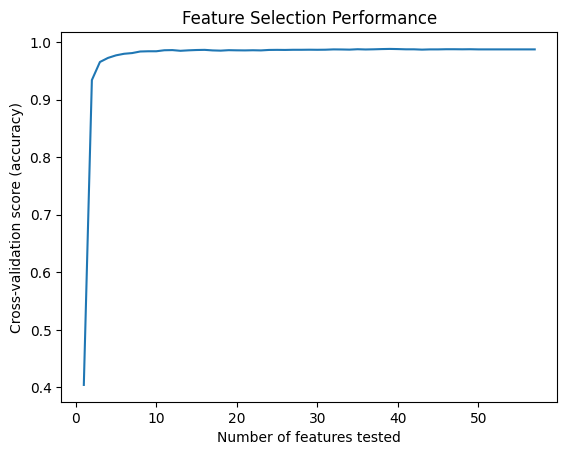

In [ ]:
# Print the optimal number of features found by RFECV.
print("Optimal number of features : %d" % rfecv.n_features_)

# Retrieve the cross-validation results from the RFECV.
cv_results = rfecv.cv_results_

# Plot the cross-validation results, showing the relationship between the number of features and cross-validation accuracy.
plt.figure()
plt.xlabel("Number of features tested")
plt.ylabel("Cross-validation score (accuracy)")
plt.plot(range(1, len(cv_results['mean_test_score']) + 1), cv_results['mean_test_score'])
plt.title("Feature Selection Performance")
plt.show()

In [ ]:
# Transform the training and testing datasets to reduce to the selected optimal features.
X_train_selected = rfecv.transform(X_train_reshaped)
X_test_selected = rfecv.transform(X_test_reshaped)

# Fit the SVM classifier with the selected features.
svc_fs.fit(X_train_selected, y_train_ravel)

# Predict using the trained SVM on the test dataset with selected features.
y_pred_rfecv = svc_fs.predict(X_test_selected)

# Calculate and print the accuracy of the model on the test data.
accuracy = accuracy_score(y_test, y_pred_rfecv)
print(f"Test Accuracy: {accuracy:.4f}")


Test Accuracy: 0.9654


Confusion Matrix:
 [[493   0   3   0   0   0]
 [ 14 455   2   0   0   0]
 [  4   7 409   0   0   0]
 [  0   2   0 435  54   0]
 [  0   0   0  16 516   0]
 [  0   0   0   0   0 537]]
Classification Report:
                     precision    recall  f1-score   support

           WALKING       0.96      0.99      0.98       496
  WALKING_UPSTAIRS       0.98      0.97      0.97       471
WALKING_DOWNSTAIRS       0.99      0.97      0.98       420
           SITTING       0.96      0.89      0.92       491
          STANDING       0.91      0.97      0.94       532
            LAYING       1.00      1.00      1.00       537

          accuracy                           0.97      2947
         macro avg       0.97      0.96      0.97      2947
      weighted avg       0.97      0.97      0.97      2947



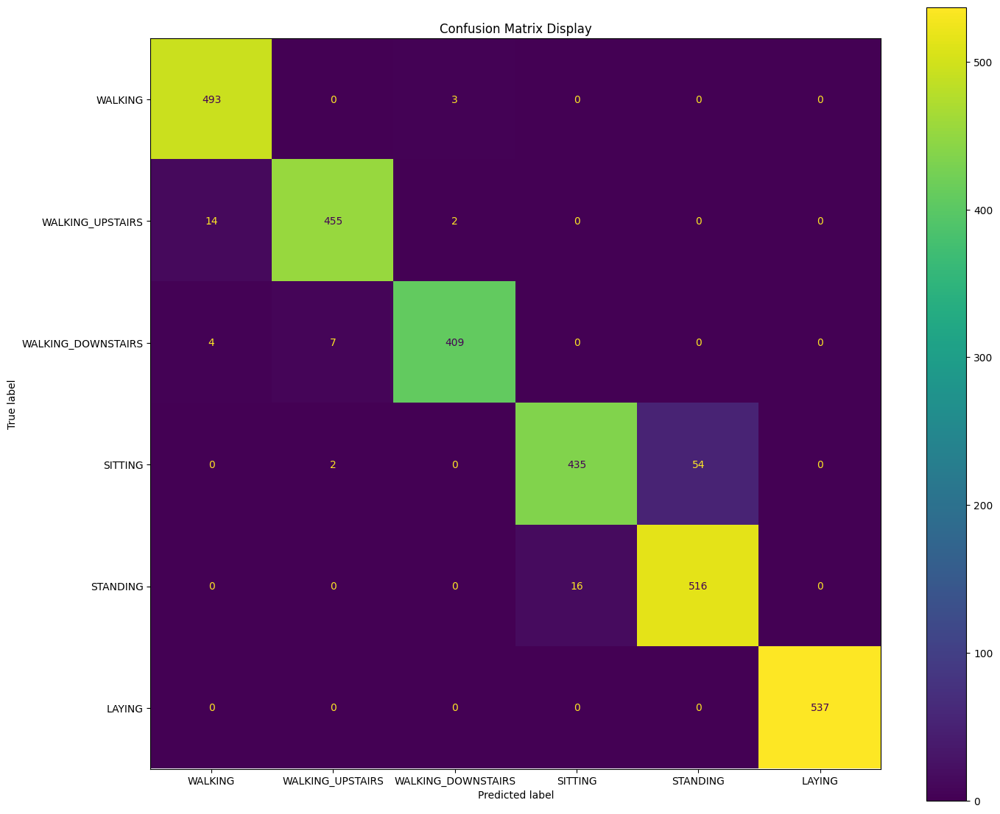

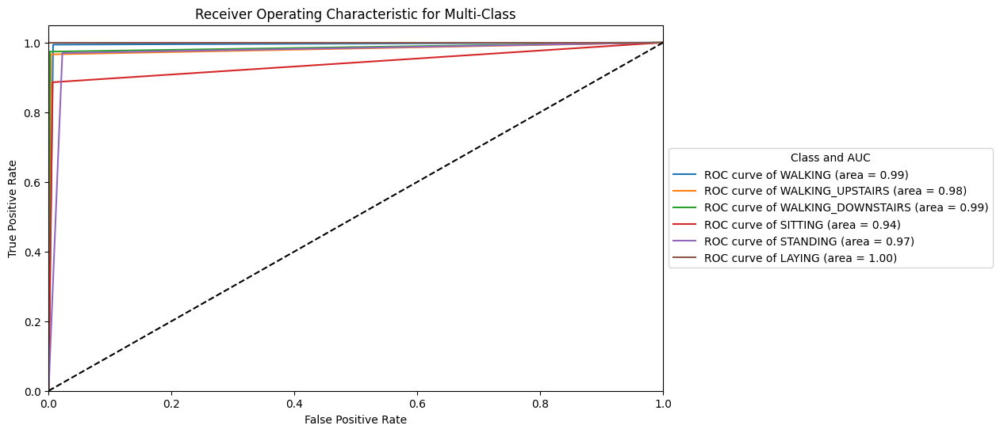

In [ ]:
# Evaluate the classifier performance using the predefined function that prints classification metrics.
evaluate_classification(y_test, y_pred_rfecv ,class_names)

# Plot ROC curves to assess the effectiveness of the classifier across multiple classes.
plot_multi_class_roc(y_test, y_pred_rfecv ,class_names)

# Compare all Models

In [ ]:
# Define a function to evaluate and store accuracy, precision, recall, and F1 score for given model predictions.
def evaluate_models(y_true, predictions, model_names):
    metrics = {}
    for pred, name in zip(predictions, model_names):
        accuracy = accuracy_score(y_true, pred)
        precision, recall, fscore, _ = precision_recall_fscore_support(y_true, pred, average='weighted')
        metrics[name] = {
            'Accuracy': accuracy,
            'Precision': precision,
            'Recall': recall,
            'F1 Score': fscore
        }
    return metrics

# List of predictions from various models for comparison.
models_predictions = [predictions_cnn, y_pred_ml, predictions_pca, y_pred_rfecv]

# Corresponding names of the models.
model_names = ['Neural Network', 'Simple SVM', 'PCA SVM', 'Feature Selection SVM']

# Evaluate all models and store their performance metrics.
model_metrics = evaluate_models(y_test, models_predictions, model_names)

# Print performance metrics for each model.
for model_name, metrics in model_metrics.items():
    print(f"Metrics for {model_name}:")
    for metric_name, value in metrics.items():
        print(f"{metric_name}: {value:.4f}")


Metrics for Neural Network:
Accuracy: 0.7971
Precision: 0.8416
Recall: 0.7971
F1 Score: 0.7855
Metrics for Simple SVM:
Accuracy: 0.9522
Precision: 0.9526
Recall: 0.9522
F1 Score: 0.9521
Metrics for PCA SVM:
Accuracy: 0.9379
Precision: 0.9388
Recall: 0.9379
F1 Score: 0.9378
Metrics for Feature Selection SVM:
Accuracy: 0.9654
Precision: 0.9662
Recall: 0.9654
F1 Score: 0.9653


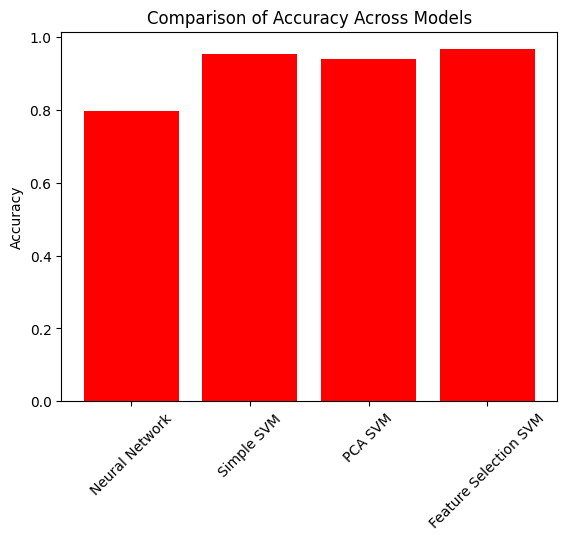

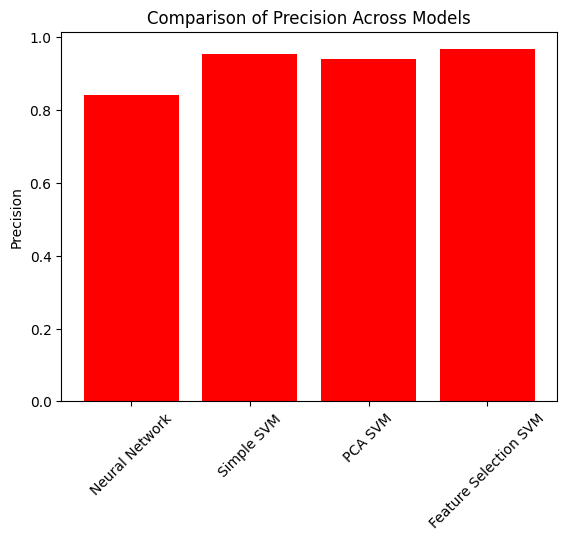

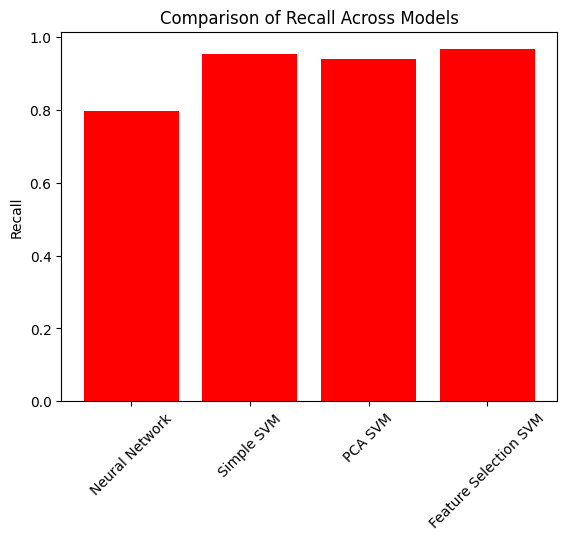

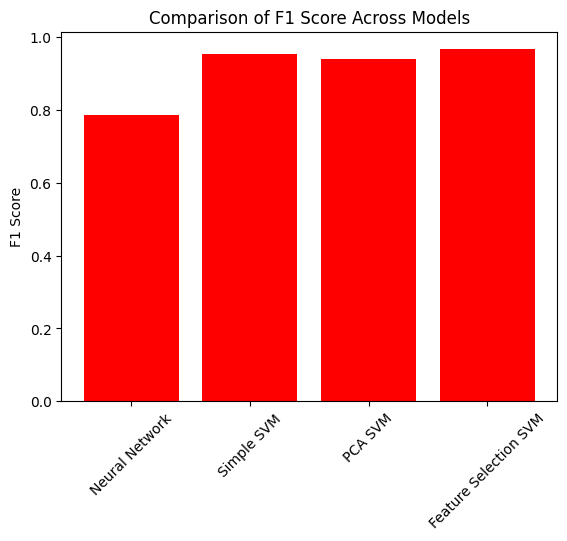

In [ ]:
# Define a function to plot a comparison of a specified metric across all models.
def plot_metrics_comparison(metrics, metric_name):
    fig, ax = plt.subplots()
    model_names = list(metrics.keys())
    values = [m[metric_name] for m in metrics.values()]

    ax.bar(model_names, values, color='red')
    plt.ylabel(metric_name)
    plt.title(f'Comparison of {metric_name} Across Models')
    plt.xticks(rotation=45)
    plt.show()

# Plot comparisons of all key metrics across the models.
for metric in ['Accuracy', 'Precision', 'Recall', 'F1 Score']:
    plot_metrics_comparison(model_metrics, metric)


# Explainable AI method

## Lime

In [ ]:
#Define Model
model_svm = SVC(kernel='linear', probability=True)
model_svm.fit(X_train_scaled, y_train_ravel)

SVC(kernel='linear', probability=True)

In [ ]:
features_names = X_train_df.columns

In [ ]:
# Create a LimeTabularExplainer
explainer = lime_tabular.LimeTabularExplainer(
    training_data=X_train_scaled,
    feature_names=features_names,
    class_names=class_names
)
explainer = lime_tabular.LimeTabularExplainer(
    training_data=X_train_scaled,
    feature_names=features_names,
    class_names=class_names)
idx = 10
for i in range(idx):
  exp = explainer.explain_instance(X_test_scaled[i], model_svm.predict_proba, num_features=10)

# Show the explanation
  exp.show_in_notebook(show_table=True)